# Introduction to NLP

## Definition
**Natural Language Processing**, or NLP for short, is broadly defined as the automatic manipulation
of natural language, like speech and text, by software.More specifically,the area of **sentiment analysis**
, which is also known as opinion mining, is the computational study of people’s opinions, sentiments, 
emotions, appraisals, and attitudes towards entities such as products, services, organizations, 
individuals, issues, events, topics, and their attributes.

## Growth of sentiment analysis
Since early 2000, sentiment analysis has 
grown to be one of the most active research areas in natural language processing (NLP). It is also 
widely studied in data mining, Web mining, text mining, and information retrieval. In fact, it has 
spread from computer science to management sciences and social sciences such as marketing, 
finance, political science, communications, health science, and even history, due to its importance to 
business and society as a whole.

## The importance of sentiment analysis
This proliferation is due to the fact that opinions are central to 
almost all human activities and are key influencers of our behaviours. Our beliefs and perceptions of 
reality, and the choices we make, are, to a considerable degree, conditioned upon how others see 
and evaluate the world. For this reason, whenever we need to make a decision we often seek out 
the opinions of others. This is not only true for individuals but also true for organizations. 
Nowadays, if one wants to buy a consumer product, one is no longer limited to asking one’s friends 
and family for opinions because there are many user reviews and discussions about the product in 
public forums on the Web. For an organization, it may no longer be necessary to conduct surveys, 
opinion polls, and focus groups in order to gather public opinions because there is an abundance of 
such information publicly available.In recent years, we have witnessed that opinionated postings in 
social media have helped reshape businesses, and sway public sentiments and emotions, which have 
profoundly impacted on our social and political systems. Such postings have also mobilized masses 
for political changes such as those happened in some Arab countries in 2011. It has thus become a 
necessity to collect and study opinions.

<a href="https://colab.research.google.com/github/taneemishere/Sentiment-Analysis-with-Product-Reviews/blob/master/Sentiment_Analysis_with_Product_Reviews.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Implementation

## **Step 1 Read the Dataframe**

In [5]:
import pandas as pd
# Imports
import matplotlib.pyplot as plt
import seaborn as sns
color = sns.color_palette()
%matplotlib inline
import plotly.offline as py
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.tools as tls
import plotly.express as px
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
nltk.download('stopwords')
from wordcloud import WordCloud, STOPWORDS

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\panag\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [6]:
df = pd.read_csv('Reviews.csv')

In [7]:
df.head()

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text
0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,5,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...
1,2,B00813GRG4,A1D87F6ZCVE5NK,dll pa,0,0,1,1346976000,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...
2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,4,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...
3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,2,1307923200,Cough Medicine,If you are looking for the secret ingredient i...
4,5,B006K2ZZ7K,A1UQRSCLF8GW1T,"Michael D. Bigham ""M. Wassir""",0,0,5,1350777600,Great taffy,Great taffy at a great price. There was a wid...


## **Step 2 Data Analysis**

### Histogram of ratings

In [8]:
# Product Scores
fig = px.histogram(df, x="Score")
fig.update_traces(marker_color="turquoise",marker_line_color='rgb(8,48,107)',
                  marker_line_width=1.5)
fig.update_layout(title_text='Product Score')
fig.show()

We can see from the histogram above that the majority of ratings is equal to 5, so the most reviews are positive.

### The most frequent words

Stop Words: A stop word is a commonly used word (such as “the”, “a”, “an”, “in”)

 We need to remove English stopwords as they don’t add anything meaningful in the explanation and they are everyday words that we use.

In [27]:
stop_words = set(stopwords.words('english'))
stop_words.update(["br", "href"])

In [28]:
textt = " ".join(review for review in df.Text)

**WordCloud is a technique to show which words are the most frequent among the given text.**

Create the wordcloud object and remove the English stopwords.

In [29]:
wordcloud = WordCloud(stopwords=stop_words).generate(textt)

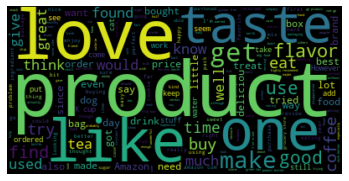

In [31]:
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.savefig('wordcloud101.png')
plt.show()

Some popular words that can be observed here include “taste,” “product,” “love,” and “Amazon.” These words are mostly positive, also indicating that most reviews in the dataset express a positive sentiment.

## Step 3 Classitying Tweets

Classifying reviews into “positive” and “negative,” so we can use this as training data for our sentiment classification model.
Positive reviews will be classified as +1, and negative reviews will be classified as -1.

We will classify all reviews:

* with **‘Score’ > 3** as **+1**, indicating that they are **positive**.

* with **‘Score’ < 3** as **-1**, indicating that they are **negative**.

* Reviews with **‘Score’ = 3 will be dropped**, because they are neutral.

Our model will only classify positive and negative reviews.

In [32]:
df = df[df['Score'] != 3]
df['sentiment'] = df['Score'].apply(lambda rating : +1 if rating > 3 else -1)

In [70]:
print(df.iloc[5030,:])

Id                                                                     5458
ProductId                                                        B00622CYVI
UserId                                                       A1Q4SDPXLHI3YN
ProfileName                                                          Jack C
HelpfulnessNumerator                                                      1
HelpfulnessDenominator                                                    1
Score                                                                     4
Time                                                             1322870400
Summary                                                         Added water
Text                      I am a strong believer in giving my baby organ...
sentiment                                                                 1
Name: 5457, dtype: object


## **Step 4 Some more data analysis**

In [34]:
# split df - positive and negative sentiment:
positive = df[df['sentiment'] == 1] 
negative = df[df['sentiment'] == -1]

**Wordcloud for positive sentiment**

In [35]:
stopwords = set(STOPWORDS)
stopwords.update(["br", "href","good","great"])

good and great removed because they were included in negative sentiment

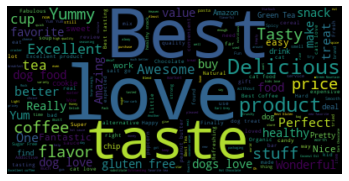

In [36]:
pos = " ".join(review for review in positive.Summary)
wordcloud2 = WordCloud(stopwords=stopwords).generate(pos)
plt.imshow(wordcloud2, interpolation='bilinear')
plt.axis("off")
plt.show()

As seen above, the positive sentiment word cloud was full of positive words, such as “love,” “best,” and “delicious.”

**Wordcloud for the negative sentiments**

In [100]:
negative = df[df['sentiment'] == -1]

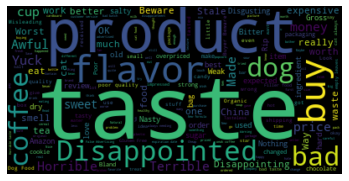

In [101]:
neg = " ".join(review for review in negative.Summary)
wordcloud3 = WordCloud(stopwords=stopwords).generate(neg)
plt.imshow(wordcloud3, interpolation='bilinear')
plt.axis("off")
plt.show()

The negative sentiment word cloud was filled with mostly negative words, such as “disappointed,” and “bad.”

Now we can take a look at the distribution of reviews with sentiment across the dataset:

In [102]:
df['sentimentt'] = df['sentiment'].replace({-1 : 'negative'})
df['sentimentt'] = df['sentimentt'].replace({1 : 'positive'})
fig = px.histogram(df, x="sentimentt")
fig.update_traces(marker_color="indianred",marker_line_color='rgb(8,48,107)',
                  marker_line_width=1.5)
fig.update_layout(title_text='Product Sentiment')
fig.show()

## **Step 5 Building the Model:**

This model will take reviews in as input. It will then come up with a prediction on whether the review is positive or negative.
This is a classification task, so we will train a simple logistic regression model to do it.

**Cleaning Data**

Remove punctuation

In [104]:
def remove_punctuation(text):
    final = "".join(u for u in text if u not in ("?", ".", ";", ":",  "!",'"'))
    return final
df['Text'] = df['Text'].apply(remove_punctuation)
df = df.dropna(subset=['Summary'])
df['Summary'] = df['Summary'].apply(remove_punctuation)

**Split the dataframe**

In [105]:
dfNew = df[['Summary','sentiment']]
dfNew.head()

,Summary,sentiment
0,Good Quality Dog Food,1
1,Not as Advertised,-1
2,Delight says it all,1
3,Cough Medicine,-1
4,Great taffy,1


We will now split the data frame into train and test sets. 80% of the data will be used for training, and 20% will be used for testing.

In [106]:
# random split train and test data
import numpy as np
index = df.index
df['random_number'] = np.random.randn(len(index))
train = df[df['random_number'] <= 0.8]
test = df[df['random_number'] > 0.8]

**Create a bag of words**

Now we will use a count vectorizer from the Scikit-learn library.
This will transform the text in our data frame into a bag of words model, which will contain a sparse matrix of integers. The number of occurrences of each word will be counted and printed.
We will need to convert the text into a bag-of-words model since the logistic regression algorithm cannot understand text.

In [107]:
# count vectorizer:
from sklearn.feature_extraction.text import CountVectorizer
vectorizer = CountVectorizer(token_pattern=r'\b\w+\b')
train_matrix = vectorizer.fit_transform(train['Summary'])
test_matrix = vectorizer.transform(test['Summary'])

document = [ “One Geek helps Two Geeks”, “Two Geeks help Four Geeks”, “Each Geek helps many other Geeks at GeeksforGeeks.”]

![Example](example.png)

**Import Logistic Regression**

In [110]:
# Logistic Regression
from sklearn.linear_model import LogisticRegression
lr = LogisticRegression()

Split target and independent variables

In [111]:
X_train = train_matrix
X_test = test_matrix
y_train = train['sentiment']
y_test = test['sentiment']

Fit the model over data

In [112]:
lr.fit(X_train,y_train)

C:\Users\User\anaconda3\envs\statistics\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



LogisticRegression()

Make Predictions

In [113]:
predictions = lr.predict(X_test)

## **Step 6 Testing the Model**

In [114]:
# find accuracy, precision, recall:
from sklearn.metrics import confusion_matrix,classification_report
new = np.asarray(y_test)
confusion_matrix(predictions,y_test)

array([[11492,  2328],
       [ 5923, 91801]], dtype=int64)

In [115]:
print(classification_report(predictions,y_test))

              precision    recall  f1-score   support

          -1       0.66      0.83      0.74     13820
           1       0.98      0.94      0.96     97724

    accuracy                           0.93    111544
   macro avg       0.82      0.89      0.85    111544
weighted avg       0.94      0.93      0.93    111544



# Algorithms

## Logistic regression

Logistic regression makes use of what is know as a binary classifier. It utilizes the Logistic function or Sigmoid function to predict a probability that the answer to some question is 1 or 0, yes or no, true or false, good or bad etc.In our case we want to classify a review as positive or negative.

Logistic Regression is an algorithm that is relatively simple and powerful for deciding between two classes, i.e. it's a binary classifier. It basically gives a function that is a boundary between two different classes. It can be extended to handle more than two classes by a method referred to as "one-vs-all" (multinomial logistic regression or softmax regression) which is really a collection of binary classifiers that just picks out the most likely class by looking at each class individually verses everything else and then picks the class that has the highest probability.

Summary:
\begin{itemize}
  \item Logistic Regression  belongs to "supervised learning" hence the training data will be labeled data and effectively will have 2 values (positive or negative)
  \item Logistic regression is a classification algorithm
  \item We want to use distance information of all data points
  \item basic idea: find the decision boundary (hyperplane) of $g(x)=\omega^T x =0$ such that maximizes $\prod_i \lvert h_i \rvert$
  \item Roughly speaking, this optimization of $\max \prod_i \lvert h_i \rvert$ tends to position a hyperplane in the middle of two classes
  \item If $\sigma(z)$ is the sigmoid function, or the logistic function
$$ \sigma(z) = \frac{1}{1+e^{-z}} \implies \sigma(\omega^T x) = \frac{1}{1+e^{-\omega^T x}}$$
 - logistic function generates a value where is always either 0 or 1
 
 - Crosses 0.5 at the origin, then flattens out
\end{itemize}


## Random forest vs Decision tree

**Decission Tree Definition:** Decision Tree is a supervised learning algorithm used in machine learning. It operated in both classification and regression algorithms. As the name suggests, it is like a tree with nodes. The branches depend on the number of criteria. It splits data into branches like these till it achieves a threshold unit. A decision tree has root nodes, children nodes, and leaf nodes.

**Random Forest Definition:** It is also used for supervised learning but is very powerful. It is very widely used. The basic difference being it does not rely on a singular decision. It assembles randomized decisions based on several decisions and makes the final decision based on the majority.It does not search for the best prediction. Instead, it makes multiple random predictions. Thus, more diversity is attached, and prediction becomes much smoother.You can infer Random forest to be a collection of multiple decision trees!

**Pros and Cons:**  A decision tree combines some decisions, whereas a random forest combines several decision trees. Thus, it is a long process, yet slow.
Whereas, a decision tree is fast and operates easily on large data sets, especially the linear one. The random forest model needs rigorous training. When you are trying to put up a project, you might need more than one model. Thus, a large number of random forests, more the time. 
